In [ ]:
!wget https://raw.githubusercontent.com/openimages/dataset/master/downloader.py
!pip install boto3 #have to do this or downloader.py crashes

--2021-05-08 20:04:22--  https://raw.githubusercontent.com/openimages/dataset/master/downloader.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4244 (4.1K) [text/plain]
Saving to: ‘downloader.py’

downloader.py       100%[===================>]   4.14K  --.-KB/s    in 0s      

2021-05-08 20:04:22 (66.9 MB/s) - ‘downloader.py’ saved [4244/4244]

     |████████████████████████████████| 133kB 20.2MB/s 
     |████████████████████████████████| 7.5MB 36.6MB/s 
     |████████████████████████████████| 81kB 11.9MB/s 
     |████████████████████████████████| 153kB 62.6MB/s 
ERROR: requests 2.23.0 has requirement urllib3!=1.25.0,!=1.25.1,<1.26,>=1.21.1, but you'll have urllib3 1.26.4 which is incompatible.
ERROR: datascience 0.10.6 has requirement folium==0.2.1, but 

In [ ]:
%mkdir OpenImageDataset
%cd OpenImageDataset

!wget https://storage.googleapis.com/openimages/v6/oidv6-train-annotations-bbox.csv #get the training boxes
!wget https://storage.googleapis.com/openimages/v5/validation-annotations-bbox.csv #get the validation boxes
!wget https://storage.googleapis.com/openimages/v5/test-annotations-bbox.csv #get the test boxes
!wget https://storage.googleapis.com/openimages/v5/class-descriptions-boxable.csv #get the class descriptions

%cd ..

/content/OpenImageDataset
--2021-05-08 20:04:29--  https://storage.googleapis.com/openimages/v6/oidv6-train-annotations-bbox.csv
Resolving storage.googleapis.com (storage.googleapis.com)... 142.250.73.208, 142.250.65.80, 142.250.73.240, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|142.250.73.208|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2258447590 (2.1G) [text/csv]
Saving to: ‘oidv6-train-annotations-bbox.csv’

oidv6-train-annotat 100%[===================>]   2.10G  52.6MB/s    in 28s     

2021-05-08 20:04:57 (77.7 MB/s) - ‘oidv6-train-annotations-bbox.csv’ saved [2258447590/2258447590]

--2021-05-08 20:04:57--  https://storage.googleapis.com/openimages/v5/validation-annotations-bbox.csv
Resolving storage.googleapis.com (storage.googleapis.com)... 172.217.7.240, 172.253.115.128, 172.253.122.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|172.217.7.240|:443... connected.
HTTP request sent, awaiting response... 

In [ ]:
import pandas as pd, csv
from google.colab import files
import numpy as np

In [ ]:
import pandas as pd
train_box = pd.read_csv('/content/OpenImageDataset/oidv6-train-annotations-bbox.csv')
train_box

,ImageID,Source,LabelName,Confidence,XMin,XMax,YMin,YMax,IsOccluded,IsTruncated,IsGroupOf,IsDepiction,IsInside,XClick1X,XClick2X,XClick3X,XClick4X,XClick1Y,XClick2Y,XClick3Y,XClick4Y
0,000002b66c9c498e,xclick,/m/01g317,1,0.012500,0.195312,0.148438,0.587500,0,1,0,0,0,0.148438,0.012500,0.059375,0.195312,0.148438,0.357812,0.587500,0.325000
1,000002b66c9c498e,xclick,/m/01g317,1,0.025000,0.276563,0.714063,0.948438,0,1,0,0,0,0.025000,0.248438,0.276563,0.214062,0.914062,0.714063,0.782813,0.948438
2,000002b66c9c498e,xclick,/m/01g317,1,0.151562,0.310937,0.198437,0.590625,1,0,0,0,0,0.243750,0.151562,0.310937,0.262500,0.198437,0.434375,0.507812,0.590625
3,000002b66c9c498e,xclick,/m/01g317,1,0.256250,0.429688,0.651563,0.925000,1,0,0,0,0,0.315625,0.429688,0.256250,0.423438,0.651563,0.921875,0.826562,0.925000
4,000002b66c9c498e,xclick,/m/01g317,1,0.257812,0.346875,0.235938,0.385938,1,0,0,0,0,0.317188,0.257812,0.346875,0.307812,0.235938,0.289062,0.348438,0.385938
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14610224,fffffdaec951185d,xclick,/m/0dzct,1,0.445625,0.672500,0.154784,0.200750,1,0,1,0,0,0.510000,0.445625,0.538125,0.672500,0.154784,0.168856,0.200750,0.176360
14610225,fffffdaec951185d,xclick,/m/0dzct,1,0.695625,0.786250,0.118199,0.297373,0,0,0,0,0,0.725000,0.748125,0.695625,0.786250,0.118199,0.297373,0.233583,0.207317
14610226,fffffdaec951185d,xclick,/m/0dzct,1,0.788750,0.835000,0.198874,0.272045,1,0,0,0,0,0.814375,0.814375,0.788750,0.835000,0.198874,0.272045,0.245779,0.247655
14610227,fffffdaec951185d,xclick,/m/0dzct,1,0.796875,0.951875,0.156660,0.205441,1,0,1,0,0,0.868750,0.796875,0.951875,0.942500,0.156660,0.176360,0.189493,0.205441


In [ ]:
labelNames = train_box['LabelName'].to_numpy()
labelNames[:10]

array(['/m/01g317', '/m/01g317', '/m/01g317', '/m/01g317', '/m/01g317',
       '/m/01g317', '/m/01g317', '/m/0284d', '/m/04bcr3', '/m/04bcr3'],
      dtype=object)

In [ ]:
imageID = train_box['ImageID'].to_numpy()
imageID[:10]

array(['000002b66c9c498e', '000002b66c9c498e', '000002b66c9c498e',
       '000002b66c9c498e', '000002b66c9c498e', '000002b66c9c498e',
       '000002b66c9c498e', '000002b66c9c498e', '000002b66c9c498e',
       '000002b66c9c498e'], dtype=object)

In [ ]:
def getBoxIndices():
  imageBoxIndices = dict() # keys are image ID, values are box indices for that image
  uniqueImages = set()
  for i in range(len(imageID)):
      id = imageID[i]
      if id not in uniqueImages:
          uniqueImages.add(id)
          imageBoxIndices[id] = [i]
      else:
          imageBoxIndices[id].append(i)
  return imageBoxIndices

In [ ]:
#set up dictionary for classes (made by Patrick)
def getClassDict():
  class_descriptions_dict = dict()
  class_descriptions_file = open('/content/OpenImageDataset/class-descriptions-boxable.csv')
  for line in class_descriptions_file:
    line = line.strip('\n')
    (id, name) = line.split(',')
    class_descriptions_dict[name] = id
  return class_descriptions_dict

In [ ]:
def getImagesWithBoxes(class_names):
    '''Get all images with at least one box for any of the labels in class_names
        - Can easily modify to get all images with at least one box for each of the labels in class_names
    
    Args:
        class_names (list): list of labels, where each label is in class_descriptions_dict.keys()

    Returns:
        imageWithBoxes (dict): keys are image IDs, values are their corresponding list of box indices that
                               have a label listed in class_names
    '''
    class_descriptions_dict = getClassDict()
    imageBoxIndices = getBoxIndices()
    class_labels = [class_descriptions_dict[class_name] for class_name in class_names]
    imagesWithBoxes = dict()
    for id, boxInds in imageBoxIndices.items():
        boxLabels = [labelNames[boxInd] for boxInd in boxInds]
        validImage = False #testing flipping these
        for class_label in class_labels:
            if class_label in boxLabels: #change this from not in to in
                validImage = True #testing flipping these
                break
        if validImage:
            imagesWithBoxes[id] = [boxInd for boxInd in boxInds if labelNames[boxInd] in class_labels]
    return imagesWithBoxes

In [ ]:
def invertClassDict():
  class_dict = getClassDict()
  inv_map = {v: k for k, v in class_dict.items()}
  return inv_map

In [ ]:
#function to get unique images for some classname
import numpy as np
def getUniqueImages(classname):
  labelNames = train_box['LabelName'].to_numpy()
  imageID = train_box['ImageID'].to_numpy()
  class_dict = getClassDict()
  object_name = class_dict[classname]
  object_locations = np.argwhere(labelNames == object_name)
  imagesWithObject = []
  for loc in object_locations:
    imagesWithObject.append(imageID[loc])
  return np.unique(imagesWithObject)

In [ ]:
xmin = train_box['XMin'].to_numpy()
xmax = train_box['XMax'].to_numpy()
ymin = train_box['YMin'].to_numpy()
ymax = train_box['YMax'].to_numpy()
labels = train_box['LabelName'].to_numpy()

In [ ]:
#returns list with (imageID, (centerx, centery, width, height)) as per yolo/darknet format
#NOTE: right now function assumes that uniqueImagesWithTrees and treeImagesWithBoxes have been intialised so it pretty much only works for trees, should be easy to generalize though.

def DarknetFormat(limit, classnames):
  darknet_formatter = []
  d = {k:v for v, k in enumerate(classnames)} #making dictionary to map classname to a number. Like Tree -> 0, Flower -> 1.
  imagesWithBoxes = getImagesWithBoxes(classnames)
  inv_dict = invertClassDict()
  allImageIDs = []
  for classname in classnames:
    count = 0
    per_class_list = []
    uniqueImages = getUniqueImages(classname)
    for imageID in uniqueImages:
      if count == limit:
        break
      elif imageID in allImageIDs:
        continue
      else:
        allImageIDs.append(imageID)
        indices = imagesWithBoxes[imageID]
        entry = []
        for index in indices:
          class_label = d[inv_dict[labels[index]]]
          centerx = (xmax[index] + xmin[index])/2
          centery = (ymax[index] + ymin[index])/2
          width = xmax[index] - xmin[index]
          height = ymax[index] - ymin[index]
          darknet_entry = (class_label, centerx, centery, width, height) #darknet formatting is class_label, x-coord of center(normalized between 0-1), y-coord of center, width, height
          entry.append(darknet_entry)
        thing = (imageID, entry) 
        per_class_list.append(thing)
      count+=1
    darknet_formatter.append(per_class_list)
  return darknet_formatter

In [ ]:
yolo = DarknetFormat(2000, ['Plate','Skyscraper','Tree','Flower']) 

In [ ]:
%mkdir labels
%cd labels

/content/labels


In [ ]:
with open("imageNaming", "x") as imageNames:
  for taggable_object in yolo:
    for entry in taggable_object:
      imageNames.write("train/" + entry[0] + "\n")
      with open(entry[0] + ".txt", "x") as imageFile:
        for yolo_format_entry in entry[1]:
          class_label = yolo_format_entry[0]
          centerx = yolo_format_entry[1]
          centery = yolo_format_entry[2]
          width = yolo_format_entry[3]
          height = yolo_format_entry[4]
          final_format = f"{class_label} {centerx} {centery} {width} {height}"
          imageFile.write(final_format + "\n")

In [ ]:
import os #for listing directory
import shutil #for moving files
shutil.move('/content/labels/imageNaming', "/content")

'/content/imageNaming'

In [ ]:
%cd ..

/content


In [ ]:
!python downloader.py /content/imageNaming --download_folder=/content/images --num_processes=5

In [ ]:
import os #for listing directory
import shutil #for moving files
import random
#split dataset into train_set, valid_set (might add test_set later)
def split_datasets(train_set, valid_set, dir_path):
  image_dir = dir_path + "/images"
  label_dir = dir_path + "/labels"
  imageEntry = os.listdir(image_dir)
  train_count = 0
  totalImages = train_set + valid_set
  remainingImages = totalImages
  for i in range(totalImages):
    image = imageEntry[random.randint(0,remainingImages-1)] #shuffling the images
    imageID = image.split(".")[0]
    image_path = image_dir + "/" + imageID + ".jpg"
    label_path = label_dir + "/" + imageID + ".txt"
    if train_count < train_set:
      if not os.path.exists("/content/train/images/" + imageID + ".jpg"): #no duplicates
        shutil.move(image_path, "/content/train/images")
        shutil.move(label_path, "/content/train/labels")
        train_count+=1
        remainingImages-=1
        imageEntry.remove(image)
      else:
        print("copy train!")
    else:
      if not os.path.exists("/content/valid/images/" + imageID + ".jpg"): #no duplicates
        shutil.move(image_path, "/content/valid/images")
        shutil.move(label_path, "/content/valid/labels")
        remainingImages-=1
        imageEntry.remove(image)
      else:
        print("copy valid!")

In [ ]:
%mkdir train #create train directory
%mkdir train/images
%mkdir train/labels

In [ ]:
%mkdir valid #create valid directory
%mkdir valid/images
%mkdir valid/labels

In [ ]:
%mkdir masterDataset
%mv /content/images /content/masterDataset
%mv /content/labels /content/masterDataset

In [ ]:
split_datasets(5600, 2400, '/content/masterDataset') #split datasets

In [ ]:
!git clone https://github.com/ultralytics/yolov5  # clone repo

Cloning into 'yolov5'...
remote: Enumerating objects: 6213, done.
remote: Counting objects: 100% (4/4), done.
remote: Compressing objects: 100% (4/4), done.
remote: Total 6213 (delta 0), reused 0 (delta 0), pack-reused 6209
Receiving objects: 100% (6213/6213), 8.46 MiB | 35.66 MiB/s, done.
Resolving deltas: 100% (4261/4261), done.


In [ ]:
%cd yolov5

/content/yolov5


In [ ]:
# install dependencies as necessary
!pip install -qr requirements.txt  # install dependencies (ignore errors)
import torch

from IPython.display import Image, clear_output  # to display images

# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

     |████████████████████████████████| 645kB 19.4MB/s 
     |████████████████████████████████| 133kB 51.0MB/s 
ERROR: datascience 0.10.6 has requirement folium==0.2.1, but you'll have folium 0.8.3 which is incompatible.
Setup complete. Using torch 1.8.1+cu101 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40)


In [ ]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [ ]:
%%writetemplate /content/data.yaml
train: /content/train/images/
val: /content/valid/images/

nc: 4
names: ['plate','skyscraper','tree','flower']

In [ ]:
%%writetemplate /content/yolov5/models/custom_yolov5s.yaml
# parameters
nc: 4  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, C3, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C3, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, C3, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, C3, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]


In [ ]:
%cd /content/yolov5

/content/yolov5


In [ ]:
!python train.py --img 640 --batch 16 --epochs 30 --data '/content/data.yaml' --cfg /content/yolov5/models/custom_yolov5s.yaml --weights yolov5s.pt

github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v5.0-74-g251aeaf torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Namespace(adam=False, artifact_alias='latest', batch_size=16, bbox_interval=-1, bucket='', cache_images=False, cfg='/content/yolov5/models/custom_yolov5s.yaml', data='/content/data.yaml', device='', entity=None, epochs=30, evolve=False, exist_ok=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[640, 640], label_smoothing=0.0, linear_lr=False, local_rank=-1, multi_scale=False, name='exp', noautoanchor=False, nosave=False, notest=False, project='runs/train', quad=False, rect=False, resume=False, save_dir='runs/train/exp3', save_period=-1, single_cls=False, sync_bn=False, total_batch_size=16, upload_dataset=False, weights='yolov5s.pt', workers=8, world_size=1)
tensorboard: Start with 'tensorboard --logdir runs/train', view at http://localhost:6006/
2021-05-08 20:17:58.753334: I tensorflow/stream_executor/platform/defaul

In [ ]:
%cp /content/yolov5/runs/train/exp3/weights/best.pt /content/drive/MyDrive #save weights file

Best mAP(mean average precision) for 1000 imgs each was 0.44


Best mAP for 2000 imgs each was 0.464

https://blog.roboflow.com/how-to-save-and-load-weights-in-google-colab/ link for saving and loading yolo models

In [ ]:
!python detect.py --weights /content/yolov5/runs/train/exp3/weights/best.pt --img 640 --conf 0.1 --source /content/testimages

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.1, device='', exist_ok=False, hide_conf=False, hide_labels=False, img_size=640, iou_thres=0.45, line_thickness=3, name='exp', nosave=False, project='runs/detect', save_conf=False, save_crop=False, save_txt=False, source='/content/testimages', update=False, view_img=False, weights=['/content/yolov5/runs/train/exp3/weights/best.pt'])
YOLOv5 🚀 v5.0-74-g251aeaf torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 224 layers, 7062001 parameters, 0 gradients, 16.4 GFLOPS
image 1/10 /content/testimages/20210502_204149.jpg: 640x480 42 flowers, Done. (0.011s)
image 2/10 /content/testimages/20210508_164247_HDR.jpg: 640x480 2 trees, 6 flowers, Done. (0.010s)
image 3/10 /content/testimages/20210508_164253.jpg: 640x480 2 flowers, Done. (0.010s)
image 4/10 /content/testimages/20210508_164742_HDR.jpg: 640x480 3 trees, 1 flower, Done. (0.010s)
image 5/10 /content/testimages/20210508_164751.jpg: 640x480

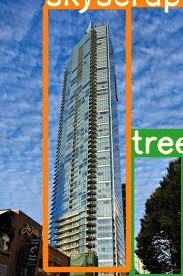

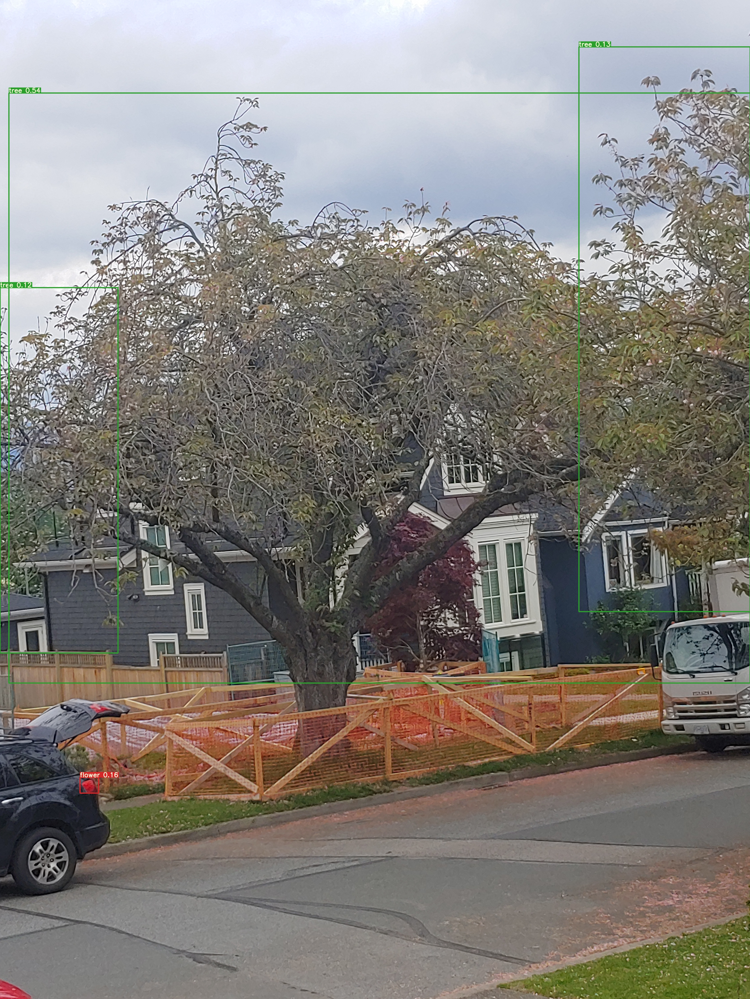

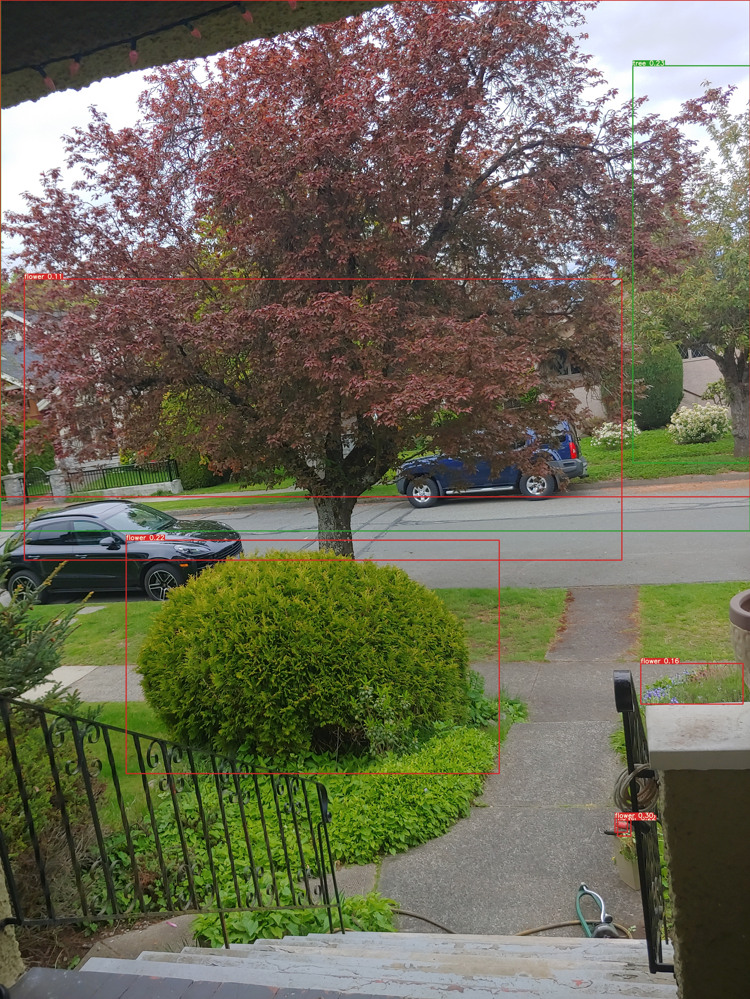

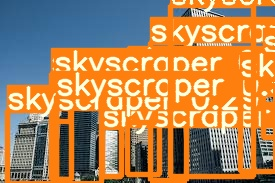

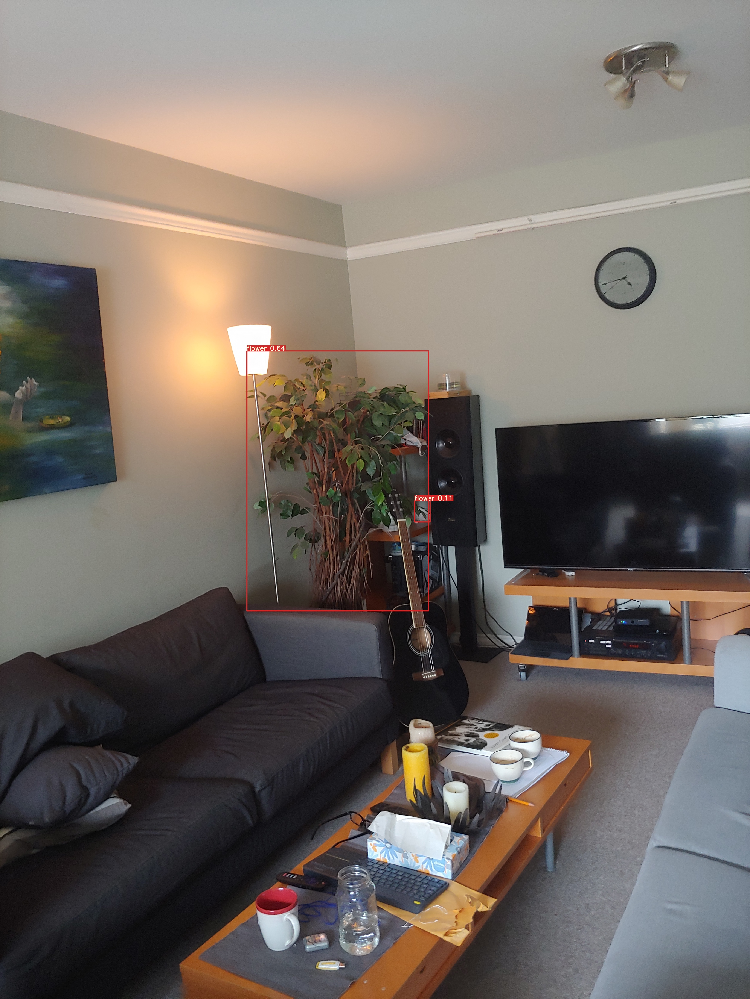

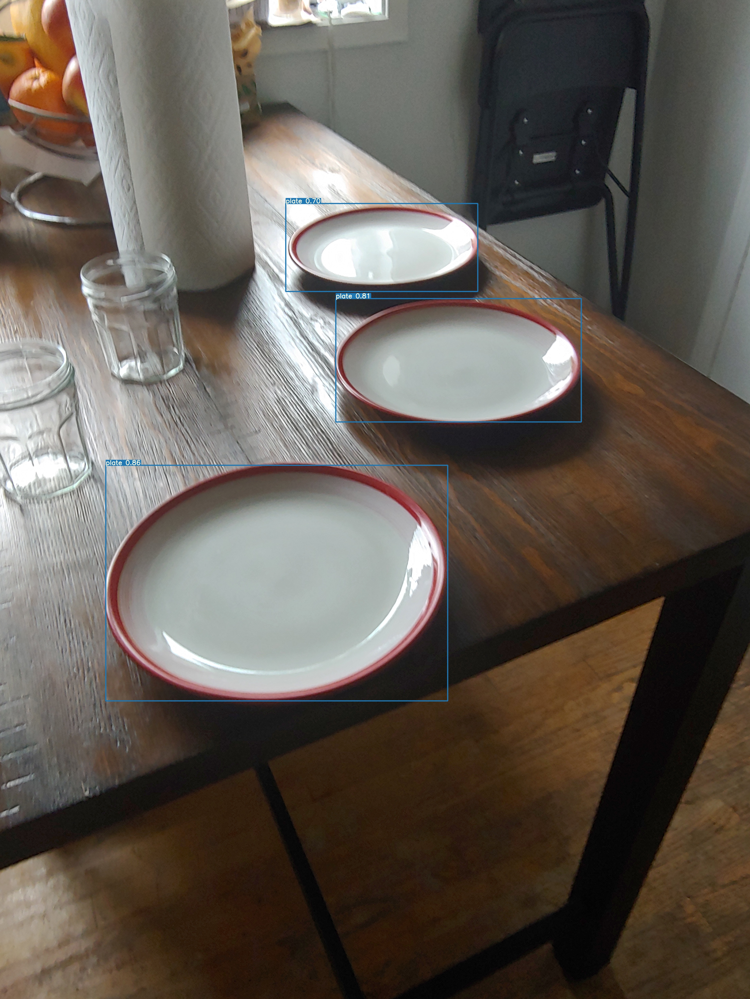

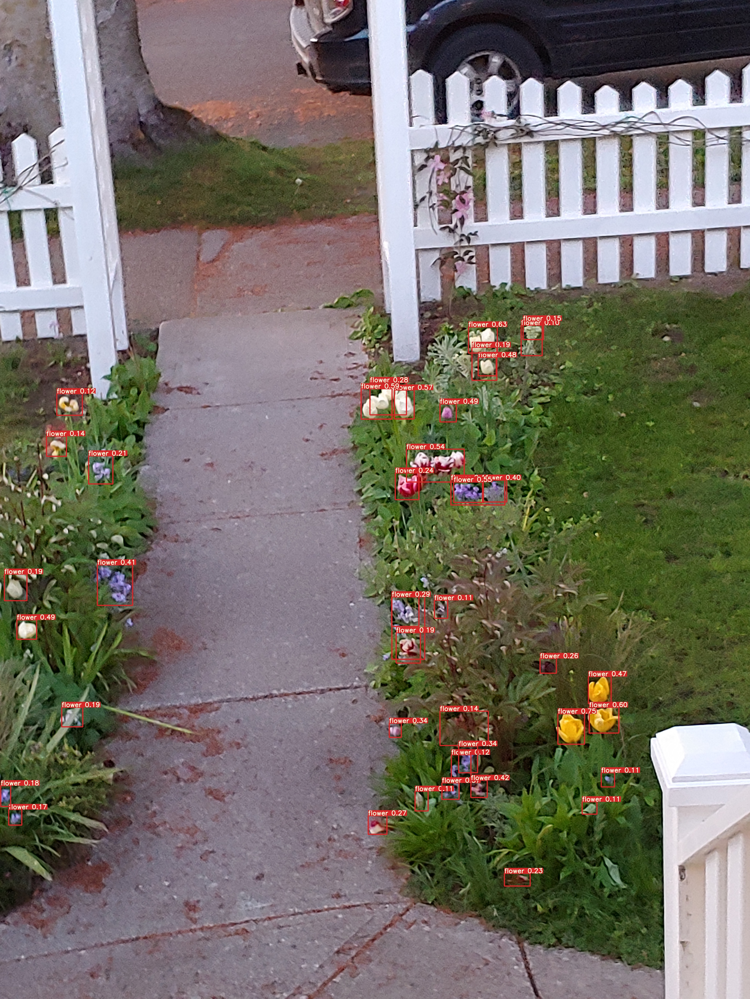

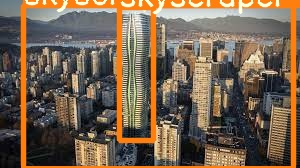

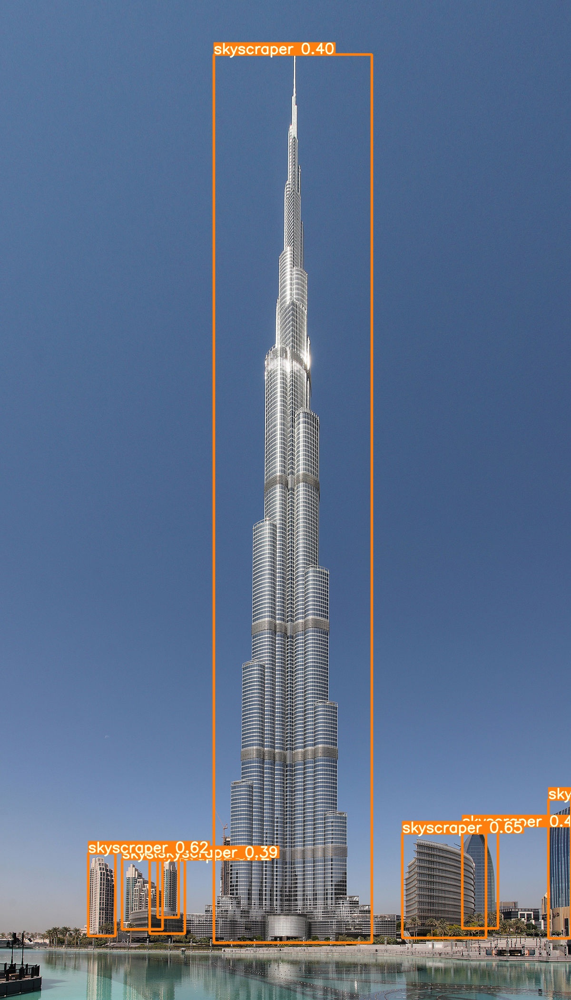

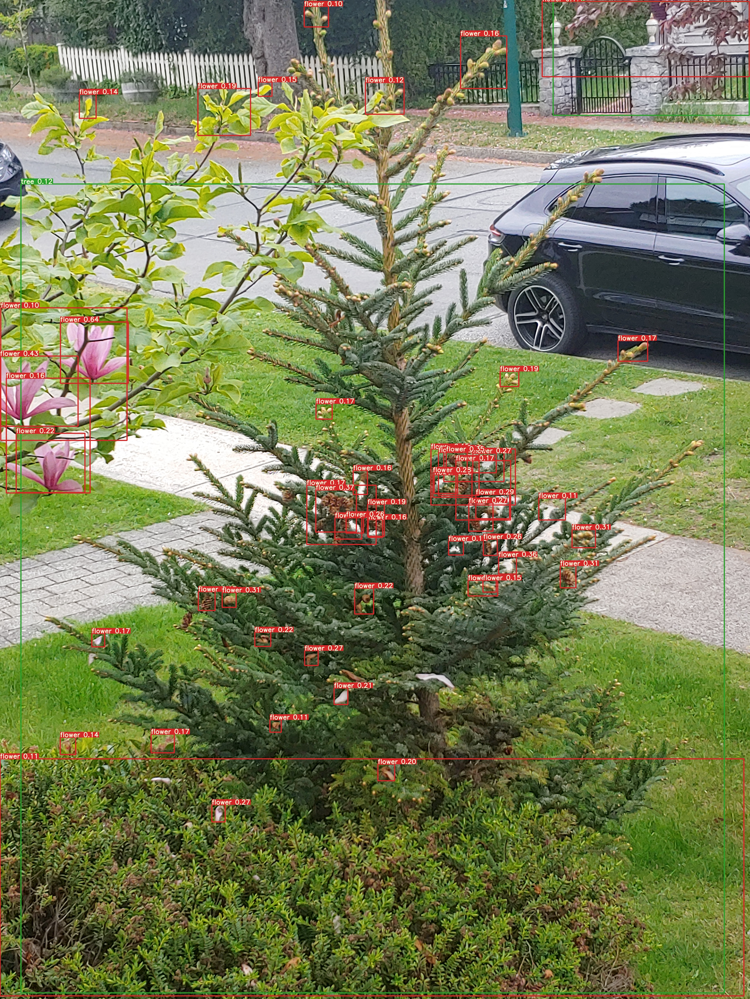

In [ ]:
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp4/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [ ]:
!python detect.py --weights /content/yolov5/runs/train/exp3/weights/best.pt --img 640 --conf 0.1 --source /content/treetest

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.1, device='', exist_ok=False, hide_conf=False, hide_labels=False, img_size=640, iou_thres=0.45, line_thickness=3, name='exp', nosave=False, project='runs/detect', save_conf=False, save_crop=False, save_txt=False, source='/content/treetest', update=False, view_img=False, weights=['/content/yolov5/runs/train/exp3/weights/best.pt'])
YOLOv5 🚀 v5.0-74-g251aeaf torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 224 layers, 7062001 parameters, 0 gradients, 16.4 GFLOPS
image 1/4 /content/treetest/109735225302838614.jpg: 640x480 13 trees, 1 flower, Done. (0.011s)
image 2/4 /content/treetest/3216173965656004335.jpg: 640x384 2 trees, Done. (0.010s)
image 3/4 /content/treetest/4237715337145663000.jpg: 640x480 15 trees, 1 flower, Done. (0.010s)
image 4/4 /content/treetest/5388338697607909698.jpg: 640x480 1 tree, Done. (0.010s)
Results saved to runs/detect/exp5
Done. (0.177s)


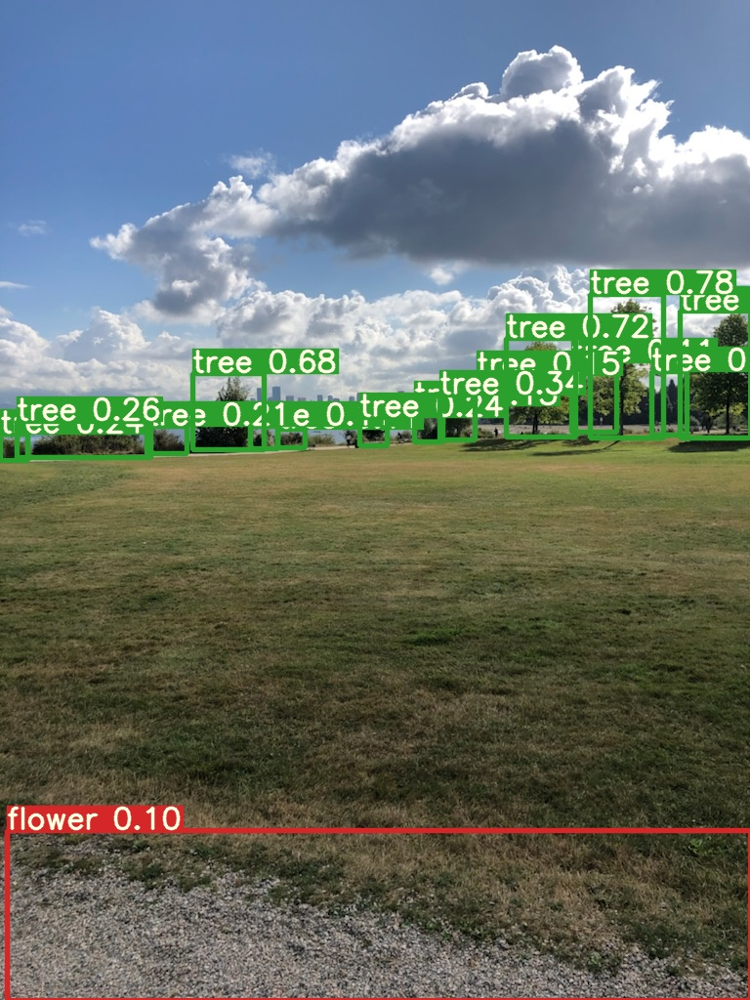

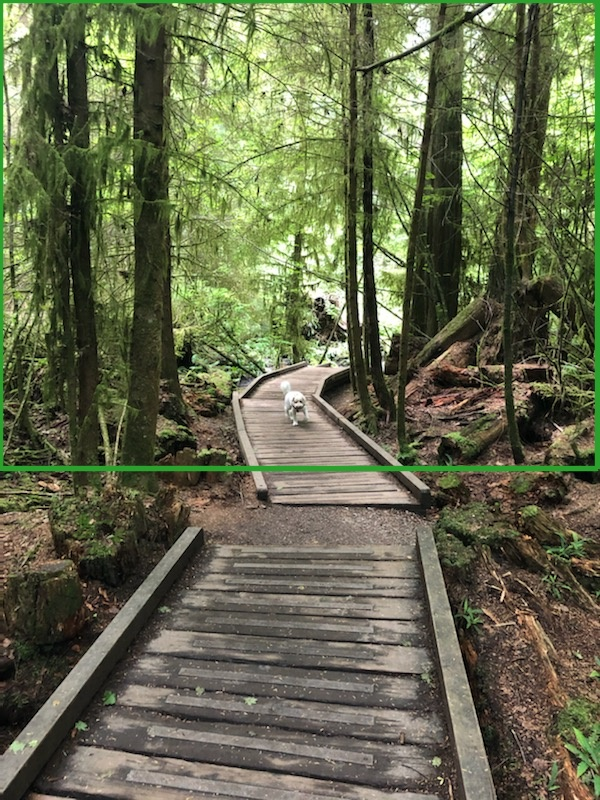

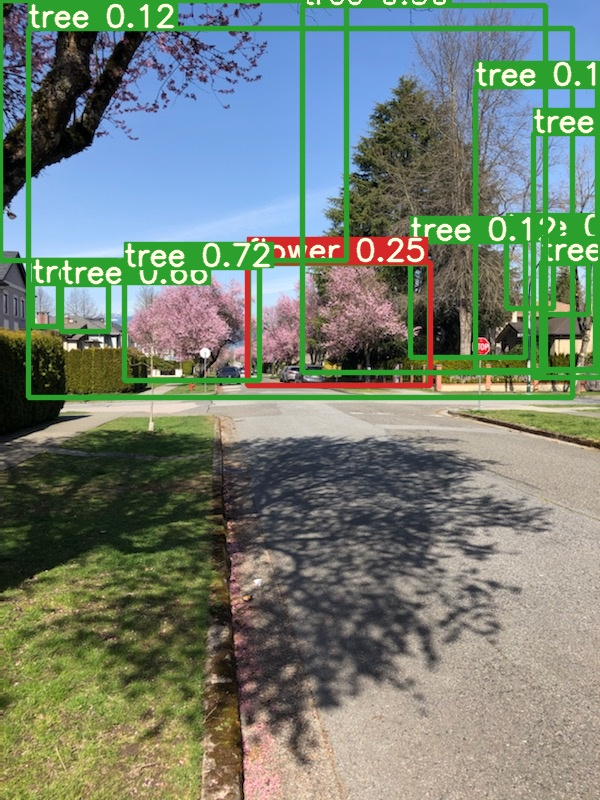

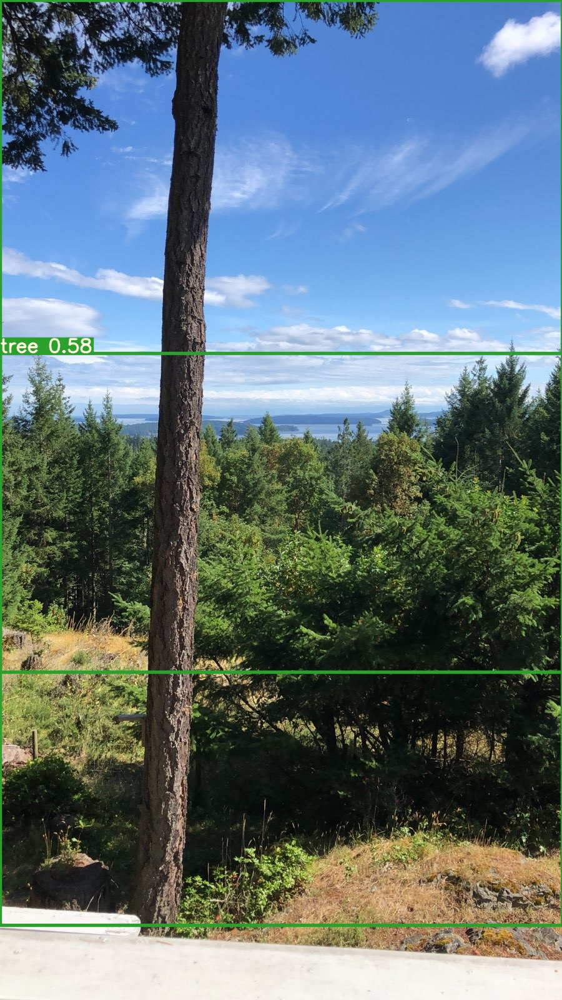

In [ ]:
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp5/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")